<a href="https://colab.research.google.com/github/maarufvazifdar/cmsc733/blob/main/maaruf_CMSC733_Assignment1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Assignment 1: 

Name: **Mohammed Maaruf Vazifdar**

UID: **117509717**

Please submit to Gradescope
- a PDF containing all outputs (by executing **Run all**)
- your ipynb notebook containing all the code

I understand the policy on academic integraty (collaboration and the use of online material).
Please sign your name here:

Mohammed Maaruf Vazifdar


# Part A: Hybrid Image (25 Points)

## Overview

A hybrid image is the sum of a *low-pass filtered* version of the one image and a *high-pass filtered* version of a second image. There is a free parameter, which can be tuned for each image pair, which controls how much high frequency to remove from the first image and how much low frequency to leave in the second image. This is called the “cutoff-frequency”. In the paper it is suggested to use two cutoff frequencies (one tuned for each image) and you are free to try that, as well. In the starter code, the cutoff frequency is controlled by changing the standard deviation of the Gausian filter used in constructing the hybrid images. [This](https://drive.google.com/uc?id=187FjBJLwnYXhylx08Vdh1SAA3AO-imYv) is the sample example.

NOTE: 

1. Reading [this](https://stanford.edu/class/ee367/reading/OlivaTorralb_Hybrid_Siggraph06.pdf) will help in understanding Part A.

2. You can use any image processing libraries of your choice such as skimage or cv2; in python.

We provided 7 pairs of aligned images. The alignment is important because it affects the perceptual grouping (read the paper for details). We encourage you to create additional examples (e.g. change of expression, morph between different objects, change over time, etc.).

You are required to provide **THREE hybrid image results** and for ONE of your favorite result, please provide answers to the following **FOUR sub-parts** mentioned in the write-up.

## Data

**WARNING: Colab deletes all files everytime runtime is disconnected. Make sure to re-download the inputs when it happens.**

In [ ]:
# Download Data -- run this cell only one time per runtime
!gdown 1KTDxPAkQam29YKtoX5dKPnLKpUOWCanC
!unzip "/content/hybrid_pyramid_input.zip" -d "/content/"

Downloading...
From: https://drive.google.com/uc?id=1KTDxPAkQam29YKtoX5dKPnLKpUOWCanC
To: /content/hybrid_pyramid_input.zip
100% 2.19M/2.19M [00:00<00:00, 91.0MB/s]
Archive:  /content/hybrid_pyramid_input.zip
   creating: /content/data/
  inflating: /content/data/Afghan_girl_before.jpg  
  inflating: /content/data/motorcycle.bmp  
  inflating: /content/data/cat.bmp   
  inflating: /content/data/makeup_before.jpg  
  inflating: /content/data/fish.bmp  
  inflating: /content/data/bicycle.bmp  
  inflating: /content/data/makeup_after.jpg  
  inflating: /content/data/plane.bmp  
  inflating: /content/data/marilyn.bmp  
  inflating: /content/data/dog.bmp   
  inflating: /content/data/Afghan_girl_after.jpg  
  inflating: /content/data/submarine.bmp  
  inflating: /content/data/bird.bmp  
  inflating: /content/data/einstein.bmp  


## Code

In [ ]:
# Helper Functions

def vis_hybrid_image(hybrid_image):
  scales = 5
  scale_factor = 0.5
  padding = 5
  original_height = hybrid_image.shape[0]
  num_colors = hybrid_image.shape[2] # counting how many color channels the input has
  output = hybrid_image
  cur_image = hybrid_image

  for i in range(2, scales):
      # add padding
      output = np.concatenate((output, np.ones((original_height, padding, num_colors), dtype=int)), axis=1)      
      # dowsample image;
      width = int(cur_image.shape[1] * scale_factor)
      height = int(cur_image.shape[0] * scale_factor)
      dim = (width, height)
      cur_image = cv2.resize(cur_image, dim, interpolation = cv2.INTER_LINEAR)
      # pad the top and append to the output
      tmp = np.concatenate((np.ones((original_height-cur_image.shape[0], cur_image.shape[1], num_colors)), cur_image), axis=0)
      output = np.concatenate((output, tmp), axis=1)
  
  output = (output * 255).astype(np.uint8)
  return output

def read_image(image_path):
  image = cv2.imread(image_path).astype('float32')
  return image

def gaussian2DFilter(size, cutoff_frequency):
  x, y = np.meshgrid(np.linspace(-2, 2, size),
                       np.linspace(-2, 2, size))
  dst = np.sqrt(x**2 + y**2)
  normal = 1 / (2 * np.pi * cutoff_frequency**2)
  gauss_filter = np.exp(-(dst**2 / (2.0 * cutoff_frequency**2))) * normal
  return gauss_filter

def imgfilter(image, filter):
  return cv2.filter2D(src=image, ddepth=-1, kernel=filter)
   
def log_mag_FFT(image):
  return 20*np.log(np.abs(np.fft.fftshift(np.fft.fft2(image))))

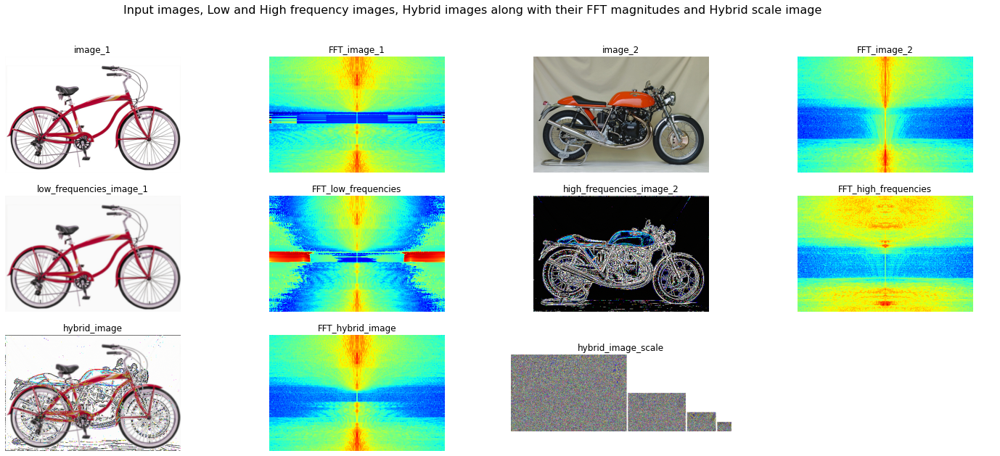

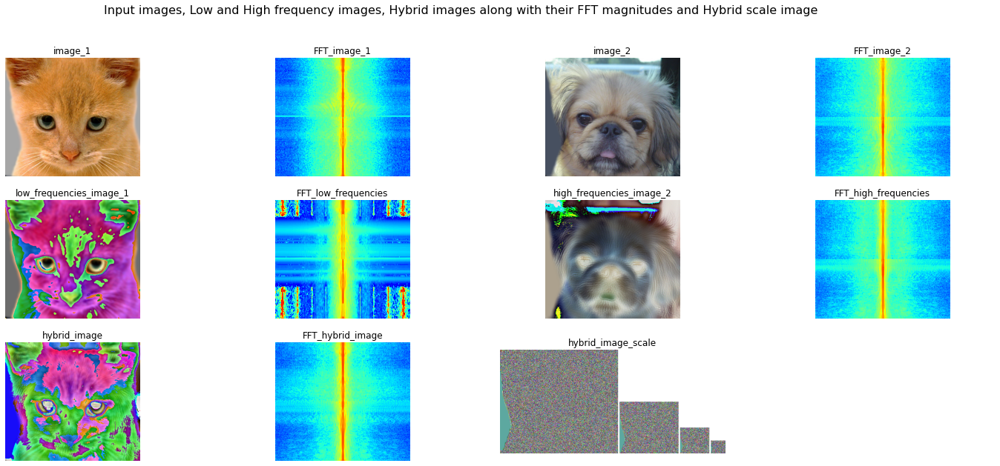

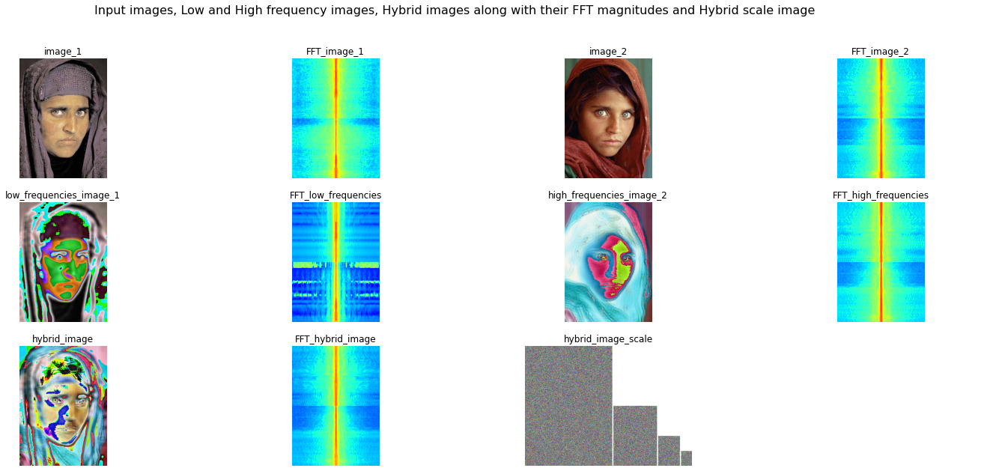

In [ ]:
# Import necessary packages here
import cv2
import numpy as np
import matplotlib.pyplot as plt
# from google.colab.patches import cv2_imshow

np.seterr(divide = 'ignore') 

def makeHybridImage(image_1, image_2, cutoff_frequency):
  image_1 = read_image(image_1)
  image_2 = read_image(image_2)

  """cutoff_frequency is the standard deviation, in pixels, of the 
  Gaussian blur that will remove the high frequencies from one image (image_1) and 
  remove the low frequencies from another image (image_2) (to do so, subtract a blurred
  version from the original version). You will want to tune this for every image pair to get the best results."""
  filter_size = cutoff_frequency * 4 + 1
  filter = gaussian2DFilter(filter_size, cutoff_frequency)

  """Use imgfilter() to create 'low_frequencies' and 'high_frequencies' and then combine them to create 'hybrid_image'.
  Remove the high frequencies from image_1 by blurring it. The amount of blur that works best will vary with different image pairs."""
  blurred_image1 = imgfilter(image_1, filter=filter)
  low_frequencies = blurred_image1

  """Remove the low frequencies from image_2. The easiest way to do this is to
  subtract a blurred version of image_2 from the original version of image_2.
  This will give you an image centered at zero with negative values."""
  blurred_image2 = imgfilter(image_2, filter=filter)
  high_frequencies = image_2 - blurred_image2

  """Combine the high frequencies and low frequencies to obtain hybrid_image."""
  hybrid_image= low_frequencies + high_frequencies

  """Firstly, visualize low_frequencies, high_frequencies, and the hybrid image."""

  """Secondly, also visualize log magnitude of Fourier Transform of the above."""
  FFT_image_1 = log_mag_FFT(image_1)
  FFT_image_2 = log_mag_FFT(image_2)
  FFT_image_low = log_mag_FFT(low_frequencies)
  FFT_image_high = log_mag_FFT(high_frequencies)
  FFT_image_hyb = log_mag_FFT(hybrid_image)

  """Thirdly, visualize hybrid_image_scale using helper function vis_hybrid_image.
  Lastly, save all your outputs."""
  hybrid_image_scale = vis_hybrid_image(hybrid_image)

  fig1, ax1 = plt.subplots(3, 4,figsize=(25, 10))
  fig1.suptitle('Input images, Low and High frequency images, Hybrid images along with their FFT magnitudes and Hybrid scale image', fontsize=16)

  plt.gcf().set_facecolor('white')
  ax1[0,0].imshow(cv2.cvtColor(image_1.astype('uint8'), cv2.COLOR_BGR2RGB))
  ax1[0,0].set_title("image_1")
  ax1[0,0].axis('off')

  ax1[0,1].imshow(cv2.cvtColor(FFT_image_1.astype('uint8'), cv2.COLOR_BGR2GRAY),cmap='jet')
  ax1[0,1].set_title("FFT_image_1")
  ax1[0,1].axis('off')

  ax1[0,2].imshow(cv2.cvtColor(image_2.astype('uint8'), cv2.COLOR_BGR2RGB))
  ax1[0,2].set_title("image_2")
  ax1[0,2].axis('off')

  ax1[0,3].imshow(cv2.cvtColor(FFT_image_2.astype('uint8'), cv2.COLOR_BGR2GRAY),cmap='jet')
  ax1[0,3].set_title("FFT_image_2")
  ax1[0,3].axis('off')

  ax1[1,0].imshow(cv2.cvtColor(low_frequencies.astype('uint8'), cv2.COLOR_BGR2RGB))
  ax1[1,0].set_title("low_frequencies_image_1")
  ax1[1,0].axis('off')

  ax1[1,1].imshow(cv2.cvtColor(FFT_image_low.astype('uint8'), cv2.COLOR_BGR2GRAY),cmap='jet')
  ax1[1,1].set_title("FFT_low_frequencies")
  ax1[1,1].axis('off')

  ax1[1,2].imshow(cv2.cvtColor(high_frequencies.astype('uint8'), cv2.COLOR_BGR2RGB))
  ax1[1,2].set_title("high_frequencies_image_2")
  ax1[1,2].axis('off')

  ax1[1,3].imshow(cv2.cvtColor(FFT_image_high.astype('uint8'), cv2.COLOR_BGR2GRAY),cmap='jet')
  ax1[1,3].set_title("FFT_high_frequencies")
  ax1[1,3].axis('off')

  ax1[2,0].imshow(cv2.cvtColor(hybrid_image.astype('uint8'), cv2.COLOR_BGR2RGB))
  ax1[2,0].set_title("hybrid_image")
  ax1[2,0].axis('off')

  ax1[2,1].imshow(cv2.cvtColor(FFT_image_hyb.astype('uint8'), cv2.COLOR_BGR2GRAY),cmap='jet')
  ax1[2,1].set_title("FFT_hybrid_image")
  ax1[2,1].axis('off')

  ax1[2,2].imshow(cv2.cvtColor(hybrid_image_scale.astype('uint8'), cv2.COLOR_BGR2RGB))
  ax1[2,2].set_title("hybrid_image_scale")
  ax1[2,2].axis('off')

  ax1[2,3].axis('off')
  plt.show()

# Main
img_pair1 = ['/content/data/bicycle.bmp', '/content/data/motorcycle.bmp', 1]
makeHybridImage(img_pair1[0], img_pair1[1],img_pair1[2])

img_pair2 = ['/content/data/cat.bmp', '/content/data/dog.bmp', 2]
makeHybridImage(img_pair2[0], img_pair2[1],img_pair2[2])

img_pair3 = ['/content/data/Afghan_girl_after.jpg', '/content/data/Afghan_girl_before.jpg', 4]
makeHybridImage(img_pair3[0], img_pair3[1],img_pair3[2])

## **Write-up**


1.   Provide the original and filtered images.
2.   Provide the the hybrid image and hybrid_image_scale using given helper function *vis_hybrid_image*.
3.   Log magnitude of the Fourier transform of the two original images, the filtered images, and the hybrid image.
4.   Briefly explain how this works, using your favorite results as illustrations.

4) Hybrid images combine the low and high frequencies of 2 images. First we take the low frequencies of image 1 that are more prominent from far distances and the high frequencies of image 2 that are better percieved at close distance and add them to generate the hybrid image. Lets take the Afghan girls example images, from close distance you can see girl in image 2 but as you move away you will see girl in image 1.

# Part B: Pyramid Image (25 Points)

## Overview
Choose an image that has interesting variety of textures (from Flickr or your own images). The images should be atleast 640X480 pixels and converted to grayscale. Write code for a Gaussian and Laplacian pyramid of level N (use for loops). In each level, the resolution should be reduced by a factor of 2. Show the pyramids for your chosen image in your write-up. Here is an [example](https://drive.google.com/uc?id=17Y287EA-GJ2z0wtm_M7StIWsXyFeHvrz).

## Data

**WARNING: Colab deletes all files everytime runtime is disconnected. Make sure to re-download the inputs when it happens.**

In [ ]:
# Download Data -- run this cell only one time per runtime
!gdown 1oOxF1fChnRtrJ7sa_L3G8UVkKlh6IOlT

Downloading...
From: https://drive.google.com/uc?id=1oOxF1fChnRtrJ7sa_L3G8UVkKlh6IOlT
To: /content/walle.jpg
100% 111k/111k [00:00<00:00, 47.8MB/s]


## Code

In [ ]:
# Helper Functions

def pyramidsGL(image, num_levels):
  '''Creates Gaussian (G) and Laplacian (L) pyramids of level "num_levels" from image im. 
  G and L are list where G[i], L[i] stores the i-th level of Gaussian and Laplacian pyramid, respectively.'''

  G.append(image)
  for i in range(num_lvl):
    gauss_img = cv2.GaussianBlur(G[i],(5,5),5)
    lap_img = G[i]  - gauss_img
    w = int(G[i].shape[1] * scale_factor)
    h = int(G[i].shape[0] * scale_factor)
    gauss_resize = cv2.resize(gauss_img,(w,h))
    G.append(gauss_resize)
    L.append(lap_img)
  G.pop(-1)
  return G, L

def log_mag_FFT(image):
  return 20*np.log(np.abs(np.fft.fftshift(np.fft.fft2(image))))

def displayPyramids(im, im_rec, G, L):
  '''Role of this function is to display intensity and Fast Fourier Transform (FFT) images of pyramids.
  NOTE: You may re-use your helper function  "log_mag_FFT" to compute this.'''
  
  # Display Gaussian/Laplacian pyramids in the required format
  fig1, ax1 = plt.subplots(2, 5,figsize=(25, 8))
  fig1.suptitle('Levels of Gaussain and Laplacian Pyramids', fontsize=16)
  plt.gcf().set_facecolor('white')

  ax1[0,0].imshow(G[0],cmap='gray')
  ax1[0,0].set_title("G1")
  ax1[0,0].axis('off')

  ax1[0,1].imshow(G[1],cmap='gray')
  ax1[0,1].set_title("G2")
  ax1[0,1].axis('off')

  ax1[0,2].imshow(G[2],cmap='gray')
  ax1[0,2].set_title("G3")
  ax1[0,2].axis('off')

  ax1[0,3].imshow(G[3],cmap='gray')
  ax1[0,3].set_title("G4")
  ax1[0,3].axis('off')

  ax1[0,4].imshow(G[4],cmap='gray')
  ax1[0,4].set_title("G5")
  ax1[0,4].axis('off')

  ax1[1,0].imshow(L[0],cmap='gray')
  ax1[1,0].set_title("L1")
  ax1[1,0].axis('off')

  ax1[1,1].imshow(L[1],cmap='gray')
  ax1[1,1].set_title("L2")
  ax1[1,1].axis('off')

  ax1[1,2].imshow(L[2],cmap='gray')
  ax1[1,2].set_title("L3")
  ax1[1,2].axis('off')

  ax1[1,3].imshow(L[3],cmap='gray')
  ax1[1,3].set_title("L4")
  ax1[1,3].axis('off')

  ax1[1,4].imshow(L[4],cmap='gray')
  ax1[1,4].set_title("L5")
  ax1[1,4].axis('off')

  # Display FFT amplitudes of Gaussian/Laplacian pyramids
  fig2, ax2 = plt.subplots(2, 5,figsize=(25, 8))
  fig2.suptitle('FFT magnitude of Gaussain and Laplacian Pyramid Levels', fontsize=16)
  plt.gcf().set_facecolor('white')
  ax2[0,0].imshow(log_mag_FFT(cv2.resize(G[0],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[0,0].set_title("FFT_G1")
  ax2[0,0].axis('off')

  ax2[0,1].imshow(log_mag_FFT(cv2.resize(G[1],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[0,1].set_title("FFT_G2")
  ax2[0,1].axis('off')

  ax2[0,2].imshow(log_mag_FFT(cv2.resize(G[2],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[0,2].set_title("FFT_G3")
  ax2[0,2].axis('off')

  ax2[0,3].imshow(log_mag_FFT(cv2.resize(G[3],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[0,3].set_title("FFT_G4")
  ax2[0,3].axis('off')

  ax2[0,4].imshow(log_mag_FFT(cv2.resize(G[4],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[0,4].set_title("FFT_G5")
  ax2[0,4].axis('off')

  ax2[1,0].imshow(log_mag_FFT(cv2.resize(L[0],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[1,0].set_title("FFT_L1")
  ax2[1,0].axis('off')

  ax2[1,1].imshow(log_mag_FFT(cv2.resize(L[1],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[1,1].set_title("FFT_L2")
  ax2[1,1].axis('off')

  ax2[1,2].imshow(log_mag_FFT(cv2.resize(L[2],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[1,2].set_title("FFT_L3")
  ax2[1,2].axis('off')

  ax2[1,3].imshow(log_mag_FFT(cv2.resize(L[3],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[1,3].set_title("FFT_L4")
  ax2[1,3].axis('off')

  ax2[1,4].imshow(log_mag_FFT(cv2.resize(L[4],(im.shape[1],im.shape[0]))), cmap='jet')
  ax2[1,4].set_title("FFT_L5")
  ax2[1,4].axis('off')

  # Display Image and Reconstructed Image
  fig3, ax3 = plt.subplots(1, 2,figsize=(25, 10))
  fig3.suptitle('Image Reconstruction', fontsize=16)
  plt.gcf().set_facecolor('white')
  
  ax3[0].imshow(im, cmap='gray')
  ax3[0].set_title("Original Image")
  ax3[0].axis('off')

  ax3[1].imshow(im_rec, cmap='gray')
  ax3[1].set_title("Reconstructed Image")
  ax3[1].axis('off')
  

  plt.show()

def reconstructLaplacianPyramid(L):
  '''Given a Laplacian Pyramid L, reconstruct an image img.'''
  for i in reversed(range(len(L)-1)):
    if i == len(L)-2:
      im_rec = L[i] + cv2.GaussianBlur((cv2.resize(L[i+1],(int(L[i+1].shape[1]/scale_factor),int(L[i+1].shape[0]/scale_factor)))),(5,5),5)
    else:
      im_rec = L[i] + cv2.GaussianBlur((cv2.resize(im_rec,(int(im_rec.shape[1]/scale_factor),int(im_rec.shape[0]/scale_factor)))),(5,5),5)
  return im_rec
  

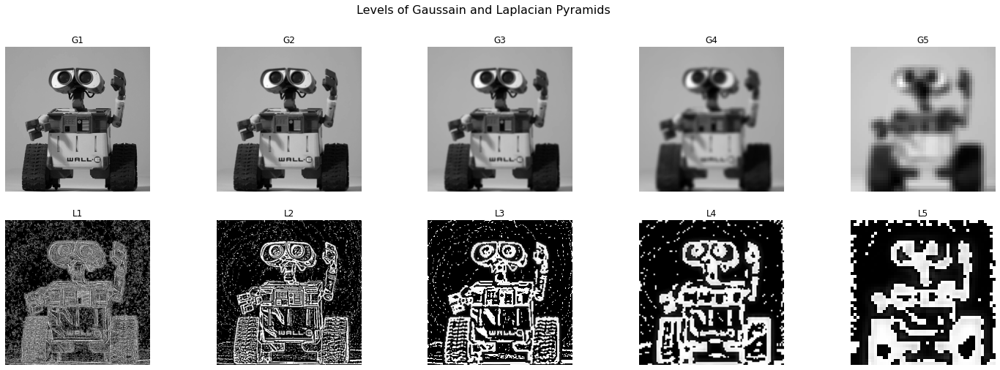

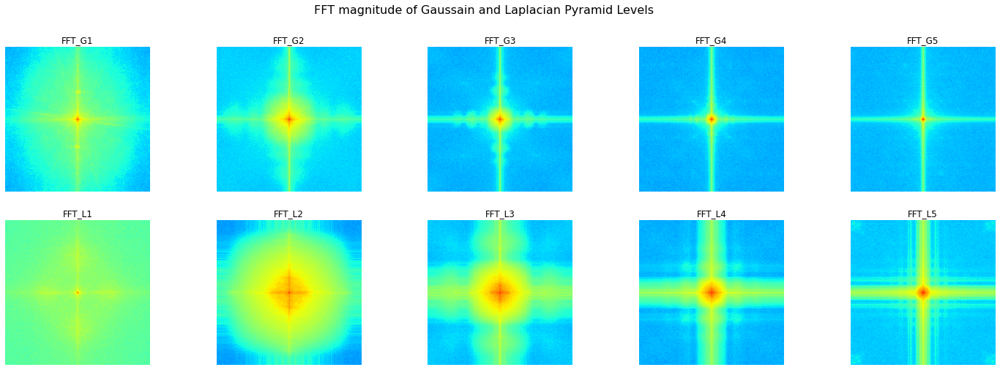

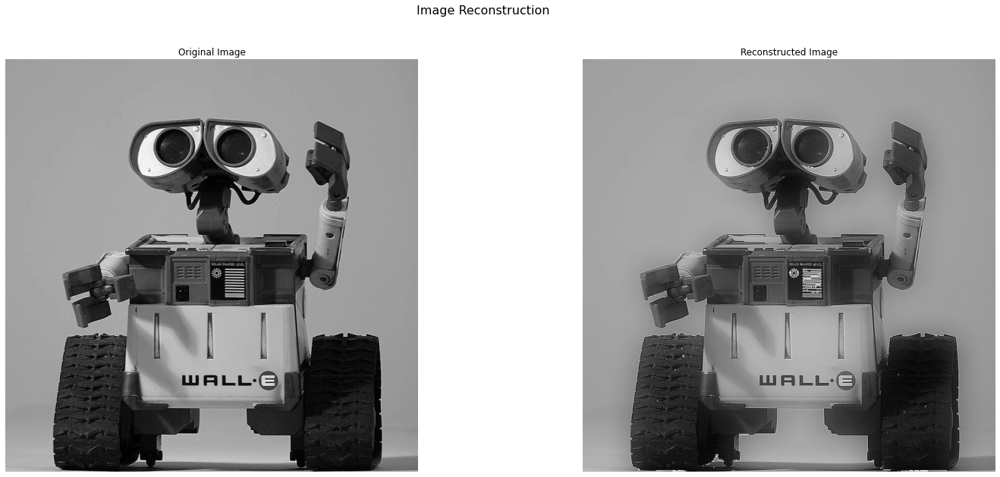

In [ ]:
""" 
Steps:
1. Load an image im.
2. Call function pyramidsGL with image and num_levels = 5
3. Call function displayPyramids with G, L
4. Call function reconstructLaplacianPyramid with the generated L
5. Compute reconstruction error with L2 norm and print the error value.
"""

import cv2
import numpy as np
import matplotlib.pyplot as plt
# from google.colab.patches import cv2_imshow

# Main
im = cv2.imread('/content/walle.jpg',0) # read image in grayscale
num_lvl = 5
scale_factor = 0.5 # scale factor

G,L = [],[]
G,L = pyramidsGL(im, num_lvl)
L_copy = L.copy()
L_copy[-1] = G[-1]
im_rec = reconstructLaplacianPyramid(L_copy)
displayPyramids(im, im_rec, G, L)

## **Write-up**

1. (10 Points) Display a Gaussian and Laplacian pyramid of level 5 (using your code). It should be formatted similar to [this](https://drive.google.com/file/d/1mAommQeJsp7WS8QCrZRcr8cQiltPPOh2/view?usp=sharing) figure.

2. (10 Points) Display the FFT amplitudes of your Gaussian/Laplacian pyramids Appropriate display ranges (from 0 to 1) should be chosen so that the changes in frequency in different levels of the pyramid are clearly visible. Explain  what the Laplacian and Gaussian pyramids are doing in terms of frequency. [This](https://drive.google.com/file/d/1BqTPKq6Mqqxl5jNNPkvx4JOA5MRgVq08/view?`usp=sharing) looks like the expected output.

3. (5 Points) Image Reconstruction


2) Gaussian Pyramid comprises of low frequency components of the image of decreasing resolution,resulting in aliasing of the image along the levels of the pyramid and . Whereas Laplacian Pyramid comprises of high frequency components of the image of decreasing resolution along the levels of the pyramid.

In terms of frequency, Gaussian pyramid preserves the low frequency components of the image along with their dominant orientations irrespective of scaling, whereas Laplacian pyramid do the same for high frequency components.

# Part C: Edge detection (25 points)

## Overview
The main steps of edge detection are: (1) assign a score to each pixel; (2) find local maxima along the direction perpendicular to the edge. Sometimes a third step is performed where local evidence is propagated so that long contours are more confident or strong edges boost the confidence of nearby weak edges. Optionally, a thresholding step can then convert from soft boundaries to hard binary boundaries. Here are sample outputs.

<table><tr>
<td> <img src="https://drive.google.com/uc?id=1orUji5-1CzjWmHk0g5y5kOVFhshNfhN8" alt="Drawing" style="width: 250px;"/> </td>
<td> <img src="https://drive.google.com/uc?id=1npyMjhlRAeP1GaukV38SOlCe-O0whX37" alt="Drawing" style="width: 250px;"/> </td>
</tr></table>
<table><tr>
<td> <img src="https://drive.google.com/uc?id=1TX54zNTG6q5ajitwV024FS-nOJiVP2VN" alt="Drawing" style="width: 250px;"/> </td>
<td> <img src="https://drive.google.com/uc?id=1dPPSFDmakh8DQwlpTYmNXJPNHapdZF8S" alt="Drawing" style="width: 250px;"/> </td>
</tr></table>

**Hint:** Reading these papers will help understanding and may help with the programming assignment.

[The design and use of steerable filters](http://people.csail.mit.edu/billf/papers/steerpaper91FreemanAdelson.pdf)

[Berkeley Pb Detector](https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/papers/mfm-pami-boundary.pdf)

[Multi-scale edge detection](https://home.ttic.edu/~xren/publication/xren_eccv08_multipb.pdf)

## Data
We have provided 50 test images and the codes associated to download the unzip the data. Your job is to build a simple gradient-based edge detector and to extend it using multiple oriented filters.

**WARNING: Colab deletes all files everytime runtime is disconnected. Make sure to re-download the inputs when it happens.**

In [ ]:
# Download Data -- run this cell only one time per runtime
!gdown 1zgblBWTQ847yZKnRmM1QrRiEWu1WvEo7
!unzip "/content/edge_detection_inputs.zip" -d "/content/"

Downloading...
From: https://drive.google.com/uc?id=1zgblBWTQ847yZKnRmM1QrRiEWu1WvEo7
To: /content/edge_detection_inputs.zip
100% 3.82M/3.82M [00:00<00:00, 186MB/s]
Archive:  /content/edge_detection_inputs.zip
   creating: /content/edge_detection_inputs/
  inflating: /content/edge_detection_inputs/65033.jpg  
  inflating: /content/edge_detection_inputs/21077.jpg  
  inflating: /content/edge_detection_inputs/41033.jpg  
  inflating: /content/edge_detection_inputs/12084.jpg  
  inflating: /content/edge_detection_inputs/108082.jpg  
  inflating: /content/edge_detection_inputs/38082.jpg  
  inflating: /content/edge_detection_inputs/45096.jpg  
  inflating: /content/edge_detection_inputs/42049.jpg  
  inflating: /content/edge_detection_inputs/89072.jpg  
  inflating: /content/edge_detection_inputs/69020.jpg  
  inflating: /content/edge_detection_inputs/103070.jpg  
  inflating: /content/edge_detection_inputs/38092.jpg  
  inflating: /content/edge_detection_inputs/85048.jpg  
  inflating: /c

## Subpart 1: Simple edge detection (8 points)
Build a simple gradient-based edge detector that includes the following functions
```
def gradientMagnitude(im, signma)
```
This function should take an RGB image as input, smooth the image with Gaussian std=sigma, compute the x and y gradient values of the smoothed image, and output image maps of the gradient magnitude and orientation at each pixel. You can compute the gradient magnitude of an RGB image by taking the L2-norm of the R, G, and B gradients. The orientation can be computed from the channel corresponding to the largest gradient magnitude. The overall gradient magnitude is the L2-norm of the x and y gradients. mag and theta should be the same size as im.

```
def edgeGradient(im):
```
This function should use gradientMagnitude to compute a soft boundary map and then perform non-maxima suppression. For this assignment, it is acceptable to perform non-maxima suppression by retaining only the magnitudes along the binary edges produce by the Canny edge detector: `cv2.Canny(im)`. 

If desired, the boundary scores can be rescaled, e.g., by raising to an exponent: `mag2 = mag.^0.7` , which is primarily useful for visualization. 


## Code

In [ ]:
# Helper Functions

def gradientMagnitude(img, sigma):
  '''
  img: input image
  sigma: standard deviation value to smooth the image

  outputs: gradient magnitude and gradient direction of the image
  '''
  img_blur = cv2.GaussianBlur(img, (3, 3), sigma)

  gauss_1d = np.array([[1,2,1]])
  gauss_1d_t = np.transpose(gauss_1d)

  x_derivative = np.array([[-1,0,1]])
  y_derivative = np.transpose(x_derivative)

  Sx = gauss_1d_t * x_derivative  # sobel - x 
  Sy = y_derivative * gauss_1d  # sobel - y

  Gx = cv2.filter2D(img_blur, -1, Sx) # x-derivative of image
  Gy = cv2.filter2D(img_blur, -1, Sy) # y-derivative of image

  G_mag = np.hypot(Gx,Gy) # Gradient magnitude
  G_mag = G_mag / G_mag.max() * 255 # rescale from 0-255

  max_grad_channel = np.argmax(G_mag,2) # channel with largest gradient magnitude
  G_orient = np.zeros_like(img)
  for i in range(img.shape[0]):
    for j in range(img.shape[1]):
      G_orient[i,j,max_grad_channel[i,j]] = np.arctan2(Gy[i,j,max_grad_channel[i,j]], Gx[i,j,max_grad_channel[i,j]])
      
  G_orient = np.rad2deg(G_orient) # Gradient
  G_orient += 180 # rescale 0-360 degrees

  return G_mag, G_orient, max_grad_channel

def edgeGradient(img, G_mag, G_orient, max_grad_channel):
  '''
  img: input image

  output: a soft boundary map of the image
  '''
  edges  = np.zeros_like(img)
  image_row, image_col = img.shape[0],img.shape[1]
  PI = 180  #in degrees
  for row in range(1, image_row - 1):
      for col in range(1, image_col - 1):
          direction = G_orient[row, col,max_grad_channel[row,col]]
  
          if (0 <= direction < PI / 8) or (15 * PI / 8 <= direction <= 2 * PI):
              before_pixel = G_mag[row, col - 1,max_grad_channel[row,col]]
              after_pixel = G_mag[row, col + 1,max_grad_channel[row,col]]
  
          elif (PI / 8 <= direction < 3 * PI / 8) or (9 * PI / 8 <= direction < 11 * PI / 8):
              before_pixel = G_mag[row + 1, col - 1,max_grad_channel[row,col]]
              after_pixel = G_mag[row - 1, col + 1,max_grad_channel[row,col]]
  
          elif (3 * PI / 8 <= direction < 5 * PI / 8) or (11 * PI / 8 <= direction < 13 * PI / 8):
              before_pixel = G_mag[row - 1, col,max_grad_channel[row,col]]
              after_pixel = G_mag[row + 1, col,max_grad_channel[row,col]]
  
          else:
              before_pixel = G_mag[row - 1, col - 1,max_grad_channel[row,col]]
              after_pixel = G_mag[row + 1, col + 1,max_grad_channel[row,col]]
  
          if G_mag[row, col,max_grad_channel[row,col]] >= before_pixel and G_mag[row, col,max_grad_channel[row,col]] >= after_pixel:
              edges[row, col,max_grad_channel[row,col]] = G_mag[row, col,max_grad_channel[row,col]]

  edges_canny = cv2.Canny(G_mag.astype('uint8'),100,200)
  return edges, edges_canny

def displayResult(img, G_mag, G_orient, edges, edges_canny):
  
  fig1, ax1 = plt.subplots(1, 3,figsize=(25, 8))
  fig1.suptitle('Simple Edge Detection', fontsize=16)
  plt.gcf().set_facecolor('white')

  ax1[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  ax1[0].set_title("Image")
  ax1[0].axis('off')

  ax1[1].imshow(cv2.cvtColor(G_mag.astype('uint8'), cv2.COLOR_BGR2RGB))
  ax1[1].set_title("Gradient Magnitude")
  ax1[1].axis('off')

  G_orient_out = skimage.exposure.rescale_intensity(G_orient, in_range='image', out_range=(0,255)).astype(np.uint8)
  ax1[2].imshow(cv2.cvtColor(G_orient_out, cv2.COLOR_BGR2RGB))
  ax1[2].set_title("Gradient Orientation")
  ax1[2].axis('off')

  fig2, ax2 = plt.subplots(1, 2,figsize=(25, 12))
  plt.gcf().set_facecolor('white')

  ax2[0].imshow(cv2.cvtColor(edges, cv2.COLOR_BGR2RGB))
  ax2[0].set_title("Non-maximum supression")
  ax2[0].axis('off')

  ax2[1].imshow(edges_canny, cmap='gray')
  ax2[1].set_title("Canny soft boundary edges")
  ax2[1].axis('off')
  plt.show()

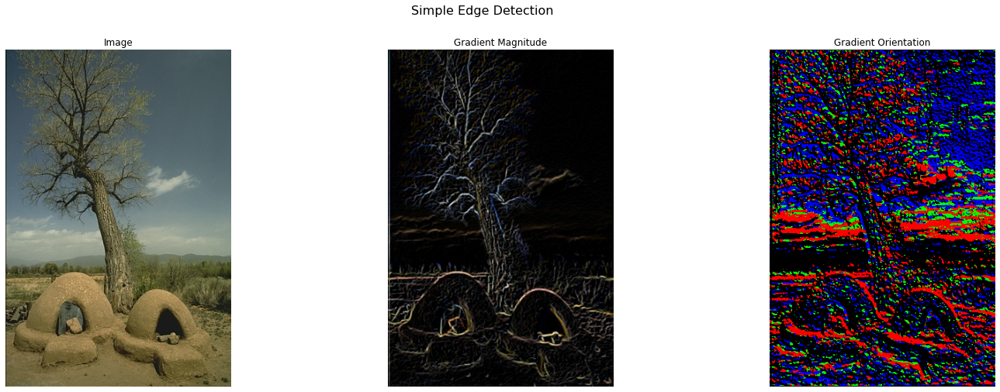

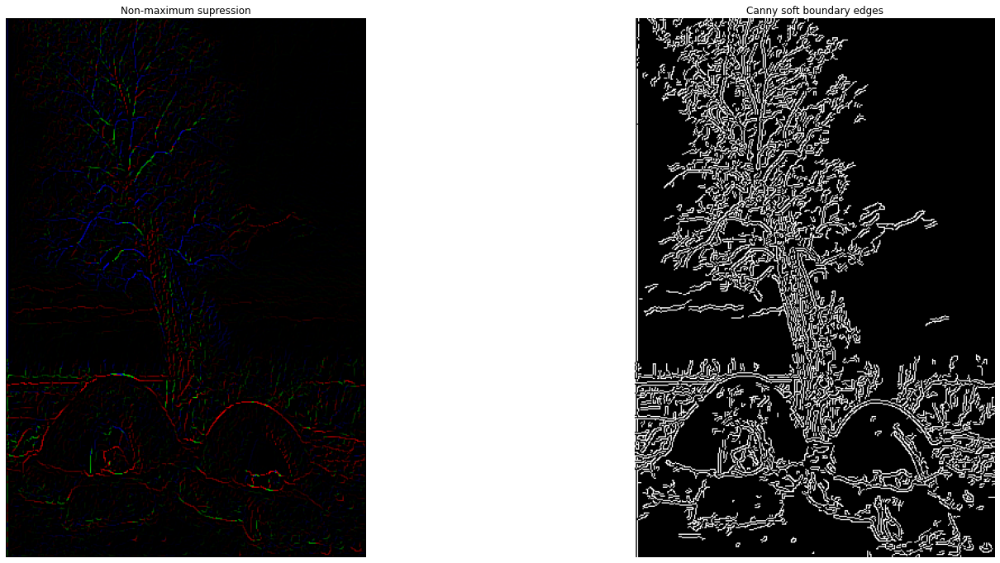

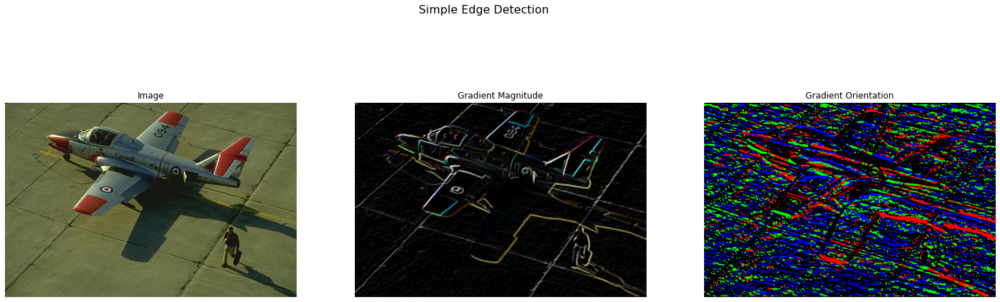

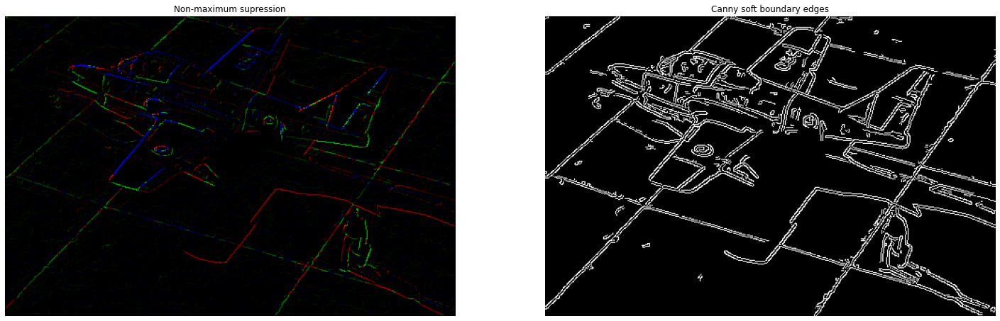

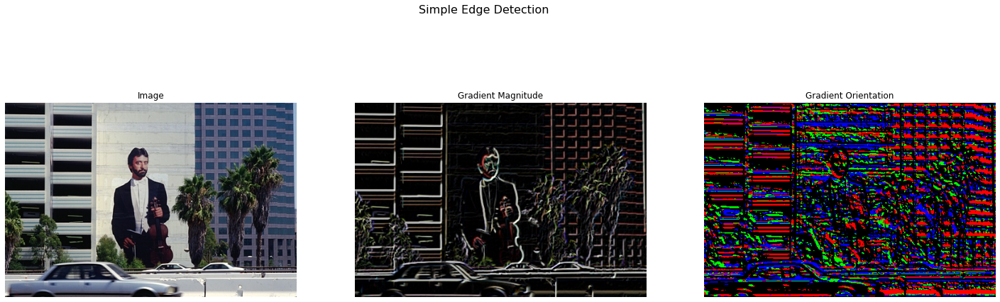

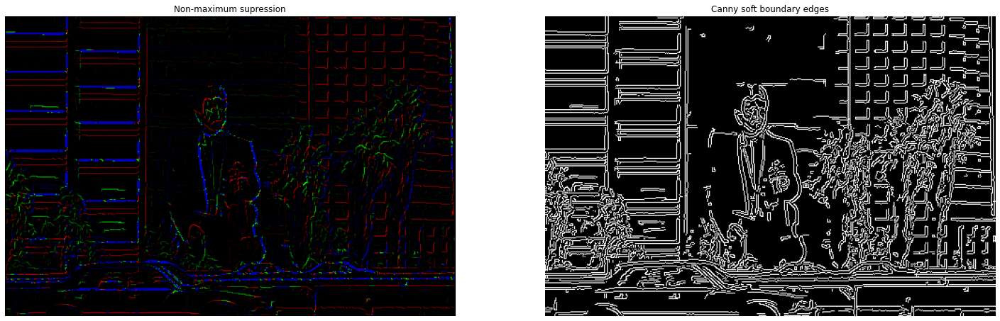

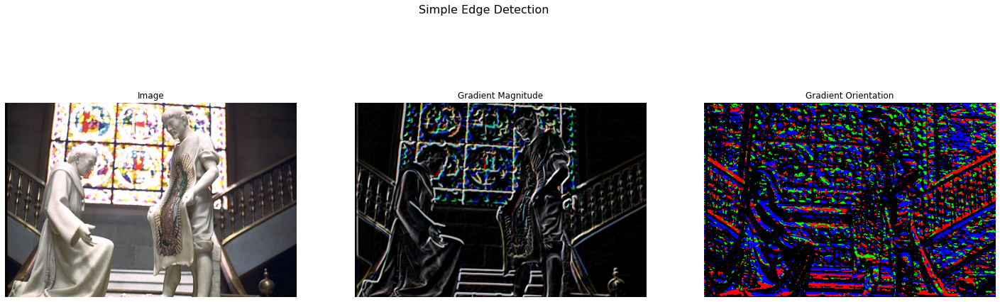

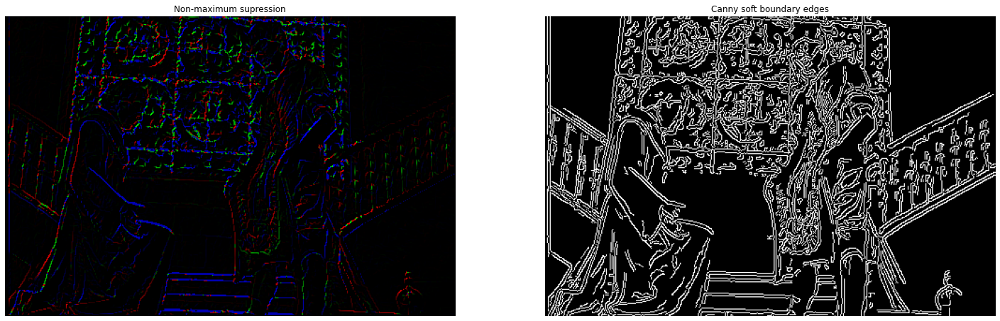

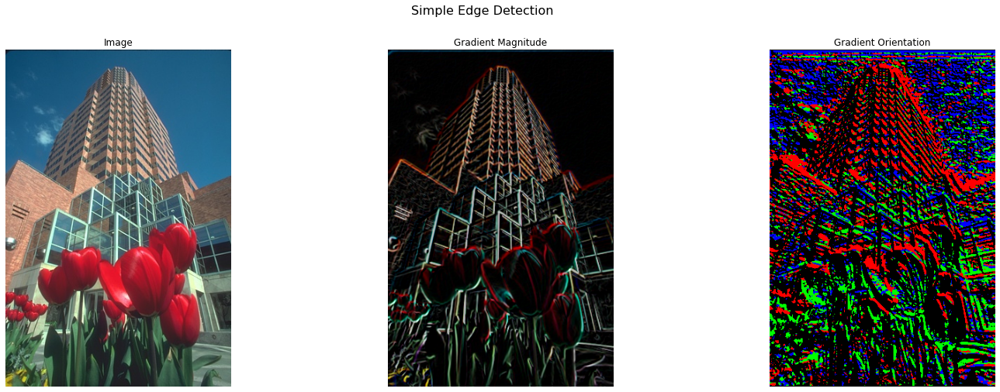

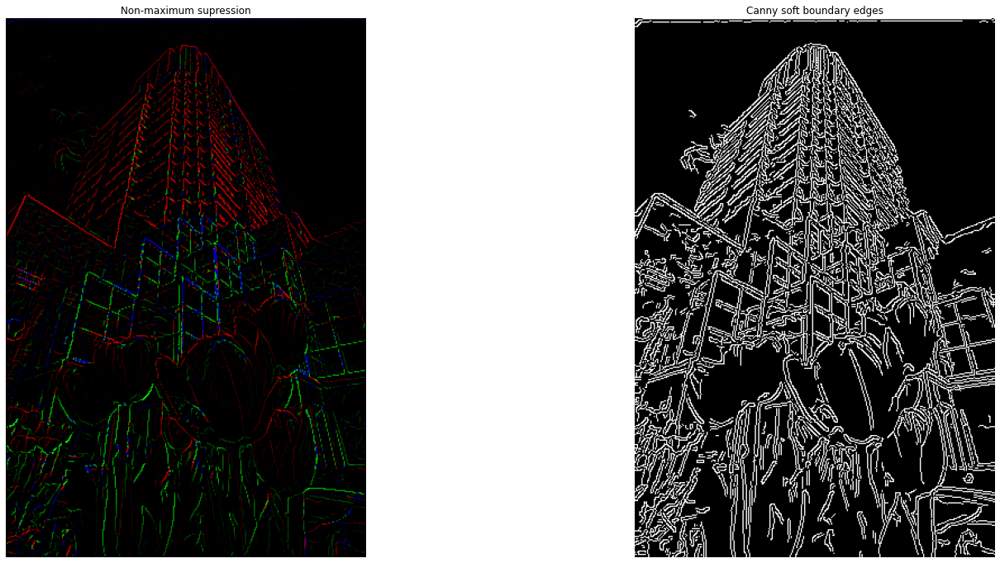

In [ ]:
# Import necessary packages
import numpy as np
import cv2
# from google.colab.patches import cv2_imshow ## Use this to show image in colab
import matplotlib.pyplot as plt
import skimage.exposure

def edge_detector(img,sigma):
  G_mag, G_orient, max_grad_channel = gradientMagnitude(img,sigma)
  edges, edges_canny = edgeGradient(img, G_mag, G_orient, max_grad_channel)
  
  displayResult(img, G_mag, G_orient, edges, edges_canny)
  
# Main
img_path = '/content/edge_detection_inputs/'
images = ['54082.jpg','37073.jpg','119082.jpg','24077.jpg','86000.jpg']
sigma = 1

for i in range(len(images)):
  img = cv2.imread(img_path + images[i])
  edge_detector(img,sigma)

## Subpart 2: Improved Edge Detection (8 points)
Try to improve your results using a set of oriented filters, rather than the simple derivative of Gaussian approach above, including the following functions:
```
def orientedFilterMagnitude(im):
```
Computes the boundary magnitude and orientation using a set of oriented filters, such as elongated Gaussian derivative filters. Explain your choice of filters in the write-up. Use at least four orientations. One way to combine filter responses is to compute a boundary score for each filter (simply by filtering with it) and then use the max and argmax over filter responses to compute the magnitude and orientation for each pixel.
```
def edgeOrientedFilters(im):
```
Similar to Subpart 1, this should call orientedFilterMagnitude, perform the non-maxima suppression, and output the final soft edge map.

## Code

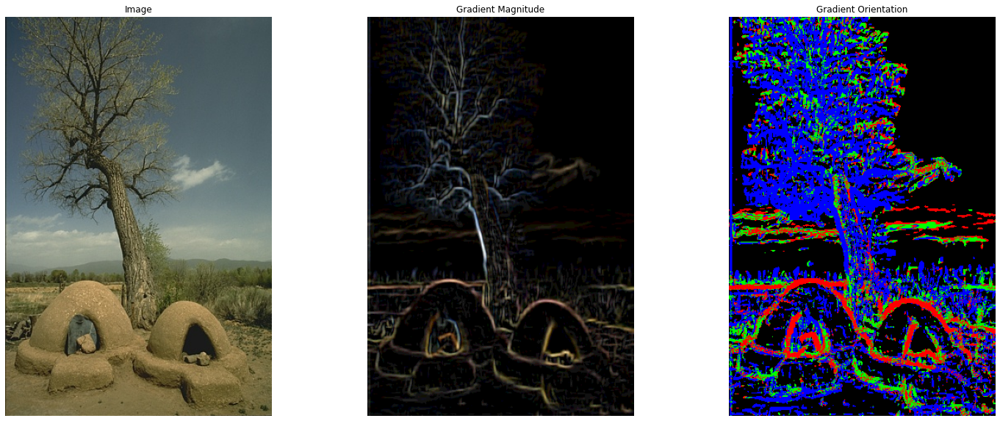

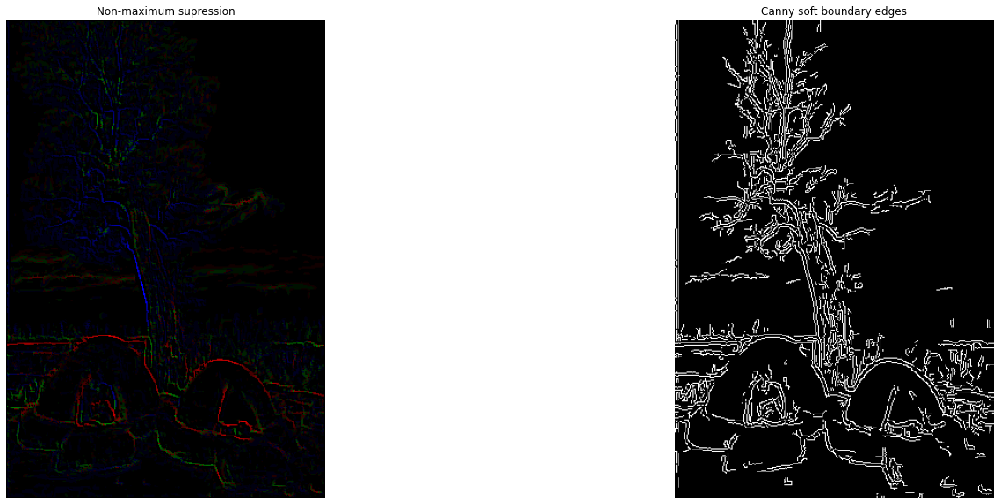

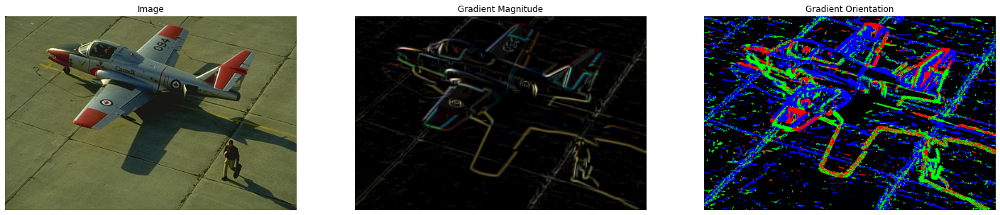

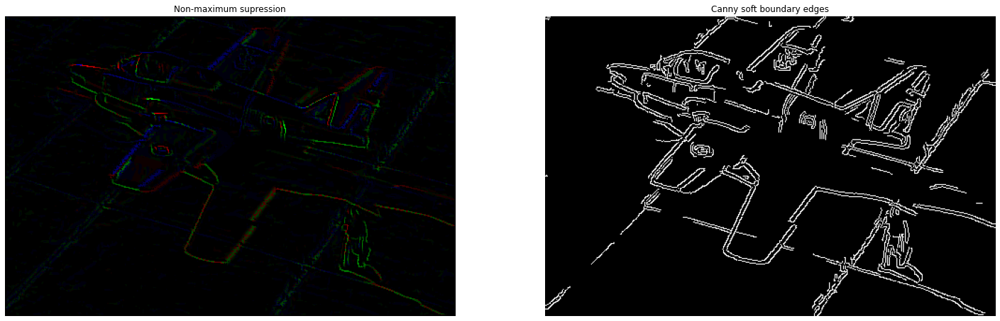

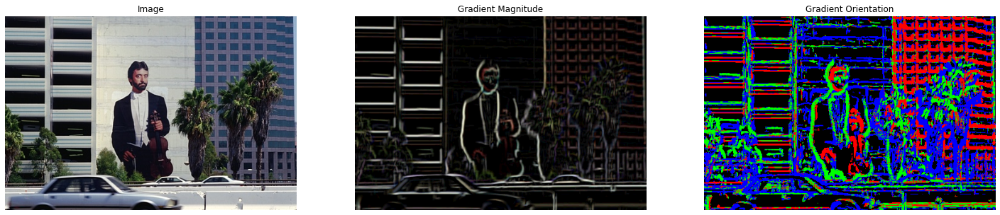

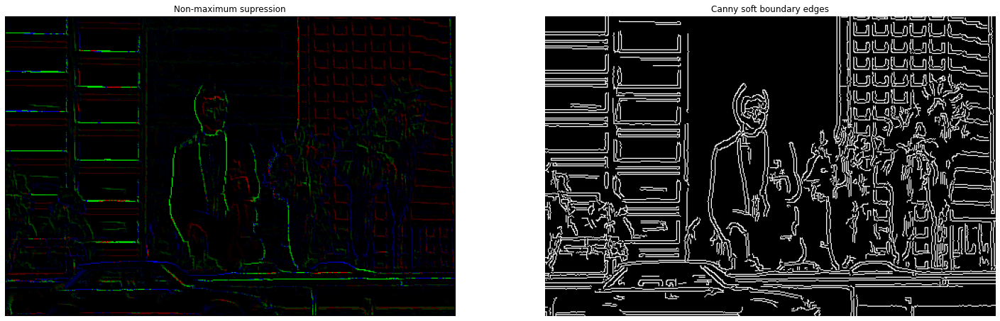

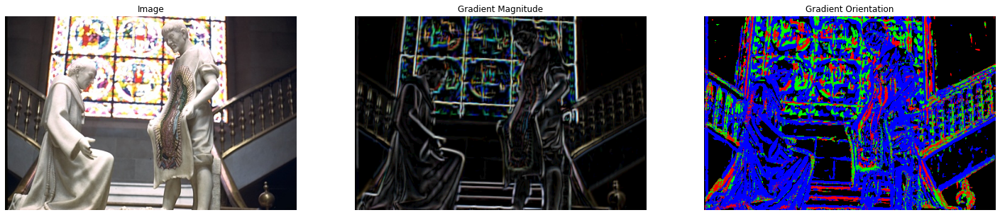

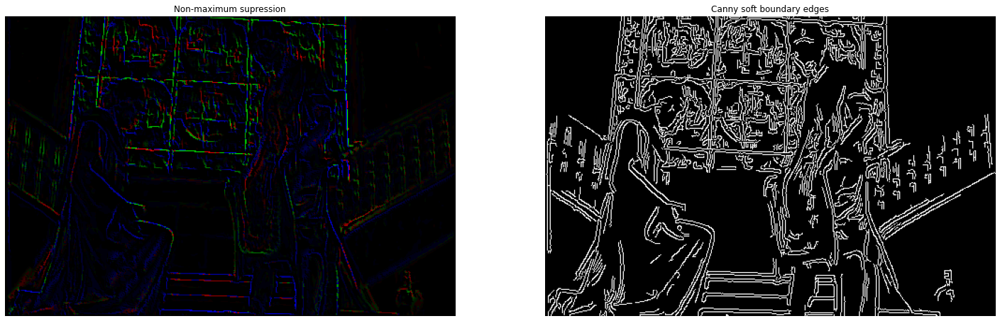

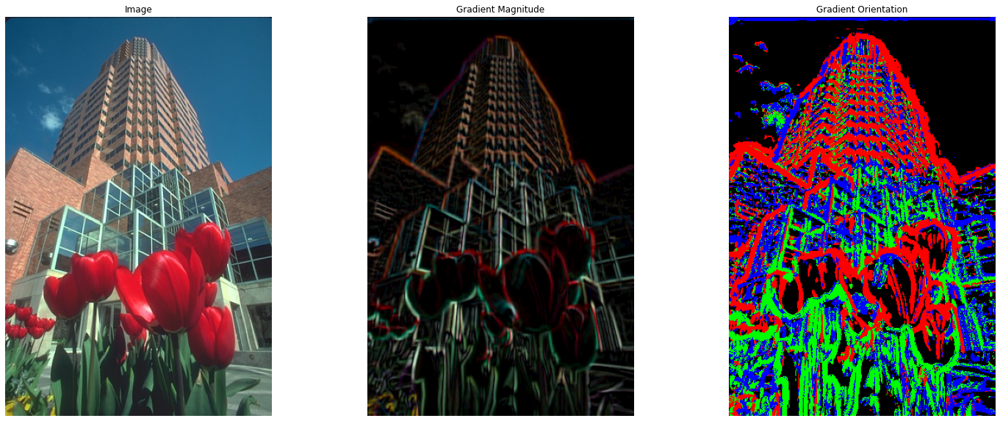

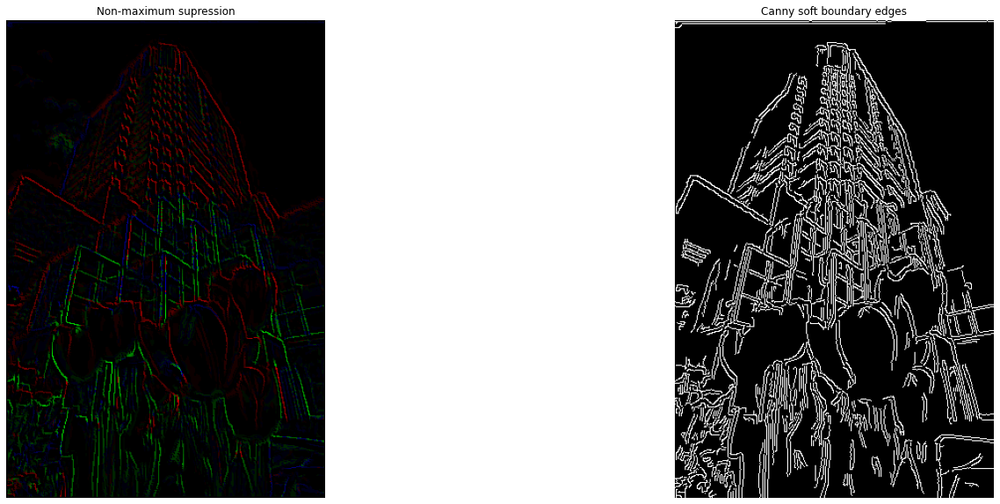

In [ ]:
def gaussian2DFilter(size, cutoff_frequency):
  x, y = np.meshgrid(np.linspace(-2, 2, size),
                       np.linspace(-2, 2, size))
  dst = np.sqrt(x**2 + y**2)
  normal = 1 / (2 * np.pi * cutoff_frequency**2)
  gauss_filter = np.exp(-(dst**2 / (2.0 * cutoff_frequency**2))) * normal
  return gauss_filter

def orientedGaussianFilters(orientations,ksize,sigma):
  filters = []
  Sx = np.array([[-1, 0, 1],[-2, 0, 2], [-1, 0, 1]])
  Sy = np.array([[1, 2, 1],[0, 0, 0], [-1, -2, -1]])

  G = gaussian2DFilter(ksize,sigma)
  DoGx = cv2.filter2D(G,-1, Sx)
  DoGy = cv2.filter2D(G,-1, Sy)

  for i in range(orientations):
    th = 180 / orientations
    filters.append((DoGx * np.cos(np.deg2rad(i*th))) +  (DoGy * np.sin(np.deg2rad(i*th))))
  return filters

def orientedFilterMagnitude(img):
  '''
  im: input image

  outputs: gradient magnitude and gradient direction of the image
  '''
  filters = orientedGaussianFilters(orientations = 4, ksize = 7, sigma = 3)
  
  img_blur = cv2.GaussianBlur(img, (3, 3), 1)
  G1 = cv2.filter2D(img_blur, -1, filters[0])
  G2 = cv2.filter2D(img_blur, -1, filters[1])
  G3 = cv2.filter2D(img_blur, -1, filters[2])
  G4 = cv2.filter2D(img_blur, -1, filters[3])

  G_mag = np.zeros_like(img)
  for i in range(img.shape[0]):
    for j in range(img.shape[1]):
      G_mag[i,j,0] = max(G1[i,j,0], G2[i,j,0], G3[i,j,0], G4[i,j,0])
      G_mag[i,j,1] = max(G1[i,j,1], G2[i,j,1], G3[i,j,1], G4[i,j,1])
      G_mag[i,j,2] = max(G1[i,j,2], G2[i,j,2], G3[i,j,2], G4[i,j,2])

  G_mag = cv2.normalize(G_mag,G_mag, 0, 255, cv2.NORM_MINMAX)

  max_grad_channel = np.argmax(G_mag,2) # index of channel with largest gradient magnitude
  G_orient = np.zeros_like(img)
  for i in range(img.shape[0]):
    for j in range(img.shape[1]):
      ang1 = np.arctan2(G1[i,j,max_grad_channel[i,j]], G2[i,j,max_grad_channel[i,j]])
      ang2 = np.arctan2(G2[i,j,max_grad_channel[i,j]], G3[i,j,max_grad_channel[i,j]])
      ang3 = np.arctan2(G3[i,j,max_grad_channel[i,j]], G4[i,j,max_grad_channel[i,j]])
      ang4 = np.arctan2(G4[i,j,max_grad_channel[i,j]], G1[i,j,max_grad_channel[i,j]])
      max_orient = max(ang1, ang2, ang3, ang4)
      G_orient[i,j,max_grad_channel[i,j]] = max_orient
      
  G_orient = np.rad2deg(G_orient) 
  G_orient += 180 # rescale 0-360 degrees
  
  return G_mag, G_orient, max_grad_channel

def edgeOrientedFilters(img, G_mag, G_orient, max_grad_channel):
  '''
  im: input image

  output: a soft boundary map of the image
  '''
  edges  = np.zeros_like(img)
  image_row, image_col = img.shape[0],img.shape[1]
  PI = 180  #in degrees
  for row in range(1, image_row - 1):
      for col in range(1, image_col - 1):
          direction = G_orient[row, col,max_grad_channel[row,col]]
  
          if (0 <= direction < PI / 8) or (15 * PI / 8 <= direction <= 2 * PI):
              before_pixel = G_mag[row, col - 1,max_grad_channel[row,col]]
              after_pixel = G_mag[row, col + 1,max_grad_channel[row,col]]
  
          elif (PI / 8 <= direction < 3 * PI / 8) or (9 * PI / 8 <= direction < 11 * PI / 8):
              before_pixel = G_mag[row + 1, col - 1,max_grad_channel[row,col]]
              after_pixel = G_mag[row - 1, col + 1,max_grad_channel[row,col]]
  
          elif (3 * PI / 8 <= direction < 5 * PI / 8) or (11 * PI / 8 <= direction < 13 * PI / 8):
              before_pixel = G_mag[row - 1, col,max_grad_channel[row,col]]
              after_pixel = G_mag[row + 1, col,max_grad_channel[row,col]]
  
          else:
              before_pixel = G_mag[row - 1, col - 1,max_grad_channel[row,col]]
              after_pixel = G_mag[row + 1, col + 1,max_grad_channel[row,col]]
  
          if G_mag[row, col,max_grad_channel[row,col]] >= before_pixel and G_mag[row, col,max_grad_channel[row,col]] >= after_pixel:
              edges[row, col,max_grad_channel[row,col]] = G_mag[row, col,max_grad_channel[row,col]]

  edges_canny = cv2.Canny(G_mag.astype('uint8'),100,200)
  return edges, edges_canny
  
def displayResult(img, G_mag, G_orient, edges, edges_canny):
  
  fig1, ax1 = plt.subplots(1, 3,figsize=(25, 10))
  plt.gcf().set_facecolor('white')

  ax1[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  ax1[0].set_title("Image")
  ax1[0].axis('off')

  ax1[1].imshow(cv2.cvtColor(G_mag.astype('uint8'), cv2.COLOR_BGR2RGB))
  ax1[1].set_title("Gradient Magnitude")
  ax1[1].axis('off')

  G_orient_out = skimage.exposure.rescale_intensity(G_orient, in_range='image', out_range=(0,255)).astype(np.uint8)
  ax1[2].imshow(cv2.cvtColor(G_orient_out, cv2.COLOR_BGR2RGB))
  ax1[2].set_title("Gradient Orientation")
  ax1[2].axis('off')

  fig2, ax2 = plt.subplots(1, 2,figsize=(25, 10))
  plt.gcf().set_facecolor('white')

  ax2[0].imshow(cv2.cvtColor(edges, cv2.COLOR_BGR2RGB))
  ax2[0].set_title("Non-maximum supression")
  ax2[0].axis('off')

  ax2[1].imshow(edges_canny, cmap='gray')
  ax2[1].set_title("Canny soft boundary edges")
  ax2[1].axis('off')
  plt.show()

# Import necessary packages
import numpy as np
import cv2
# from google.colab.patches import cv2_imshow 
import matplotlib.pyplot as plt
import skimage.exposure

def edge_detector(img):
  G_mag, G_orient, max_grad_channel = orientedFilterMagnitude(img)
  edges, edges_canny = edgeOrientedFilters(img, G_mag, G_orient, max_grad_channel)
  
  displayResult(img, G_mag, G_orient, edges, edges_canny)
  
# Main
img_path = '/content/edge_detection_inputs/'
images = ['54082.jpg','37073.jpg','119082.jpg','24077.jpg','86000.jpg']

for i in range(len(images)):
  img = cv2.imread(img_path + images[i])
  edge_detector(img)



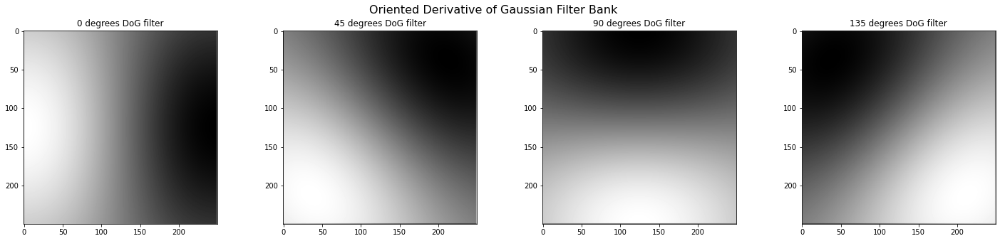

In [ ]:
def orientedGaussianFilters(orientations,ksize,sigma):
  filters = []
  Sx = np.array([[-1, 0, 1],[-2, 0, 2], [-1, 0, 1]])
  Sy = np.array([[1, 2, 1],[0, 0, 0], [-1, -2, -1]])

  G = gaussian2DFilter(ksize,sigma)
  DoGx = cv2.filter2D(G,-1, Sx)
  DoGy = cv2.filter2D(G,-1, Sy)

  for i in range(orientations):
    th = 180 / orientations
    filters.append((DoGx * np.cos(np.deg2rad(i*th))) +  (DoGy * np.sin(np.deg2rad(i*th))))
  return filters# Visualize orientedGaussianFilters 
f = orientedGaussianFilters(4,15,3)

fig1, ax1 = plt.subplots(1, 4,figsize=(25, 5))
plt.gcf().set_facecolor('white')
fig1.suptitle('Oriented Derivative of Gaussian Filter Bank', fontsize=16)

ax1[0].imshow(f[0], cmap='gray')
ax1[0].set_title("0 degrees DoG filter")

ax1[1].imshow(f[1], cmap='gray')
ax1[1].set_title("45 degrees DoG filter")

ax1[2].imshow(f[2], cmap='gray')
ax1[2].set_title("90 degrees DoG filter")

ax1[3].imshow(f[3], cmap='gray')
ax1[3].set_title("135 degrees DoG filter")

plt.show()

## Write-up (9 points)

1.   **(2 points)** Description of any design choices and parameters
2.   **(1 points)** The bank of filters used for Subpart 2 ([plt.imshow with extent](https://stackoverflow.com/questions/13384653/imshow-extent-and-aspect/13390798#13390798) or [cv2.normalize to convert output into grayscale](https://stackoverflow.com/questions/39808545/implement-mat2gray-in-opencv-with-python) may help with visualization)
3.   **(5 points)** Qualitative results: choose five example images; show input images and outputs of each edge detector
4.   **(1 points)** Discuss the quality of your outputs and state one possible way for improvement. Improvements could provide, for example, a better boundary pixel score or a better suppression technique. Your idea could come from a paper you read, but cite any sources of ideas.



1) Some design choices and parameters considered are: the kernel size and standard deviation(sigma or cutoff frequency) for generating the 2D gaussian filter and gaussain blurring. Specifically for subpart 2: Oriented Derivative of Gaussian(DoG) filter with 4 orientations(0, 45, 90 and 135 degrees) is used. Further for calculating the Gradient magnitude the maximum value along the RGB channels from the 4 filtered images is used. Gradient orientation is calculated using the maximum theta returned by atan2() from the 4 filtered images.

4) From the results it can be notices that the non-maximum supression implementation provides 3-channel edges that contain more imformation compared to the soft boundary edges produced by Canny edge detector. Possible ways of improvement can be to apply hysterisis thresholding after non-maximum supression or better tuning of Canny lower and upper thresholds. A better strategy can be used to calculate the gradient orientation over the currently used logic of using largest theta value from the 4 filtered images that causes loss of some edge information.

# Part D: Template Matching (25 points) 

## Overview
The goal of this part is to build a template maching algorithm for where's waldo puzzle. 
The end product should be finding waldo in puzzle images. 


## Data

**WARNING: Colab deletes all files everytime runtime is disconnected. Make sure to re-download the inputs when it happens.**


In [ ]:
# Download Data -- run this cell only one time per runtime
!gdown 1_PHimFhPSajbTWzAL6-PwM803uzA7Ymb
!unzip "/content/Part4_data.zip" -d "/content/"

Downloading...
From: https://drive.google.com/uc?id=1_PHimFhPSajbTWzAL6-PwM803uzA7Ymb
To: /content/Part4_data.zip
100% 2.04M/2.04M [00:00<00:00, 187MB/s]
Archive:  /content/Part4_data.zip
   creating: /content/Part4_data/
  inflating: /content/__MACOSX/._Part4_data  
  inflating: /content/Part4_data/.DS_Store  
  inflating: /content/__MACOSX/Part4_data/._.DS_Store  
   creating: /content/Part4_data/puzzle2/
  inflating: /content/__MACOSX/Part4_data/._puzzle2  
   creating: /content/Part4_data/puzzle1/
  inflating: /content/__MACOSX/Part4_data/._puzzle1  
  inflating: /content/Part4_data/puzzle2/waldo.png  
  inflating: /content/__MACOSX/Part4_data/puzzle2/._waldo.png  
  inflating: /content/Part4_data/puzzle2/map.jpg  
  inflating: /content/__MACOSX/Part4_data/puzzle2/._map.jpg  
  inflating: /content/Part4_data/puzzle1/waldo.jpg  
  inflating: /content/__MACOSX/Part4_data/puzzle1/._waldo.jpg  
  inflating: /content/Part4_data/puzzle1/pic1.jpeg  
  inflating: /content/__MACOSX/Part4_da

### Subpart 1: Template Matching with OpenCV
OpenCV provide Template Matching functions below link. 

https://docs.opencv.org/4.x/d4/dc6/tutorial_py_template_matching.html

You can use this function for implementing simple where's waldo algorithm.

This part helps you to understand the concepts of Template Matching and OpenCV Library. This is just for reference.

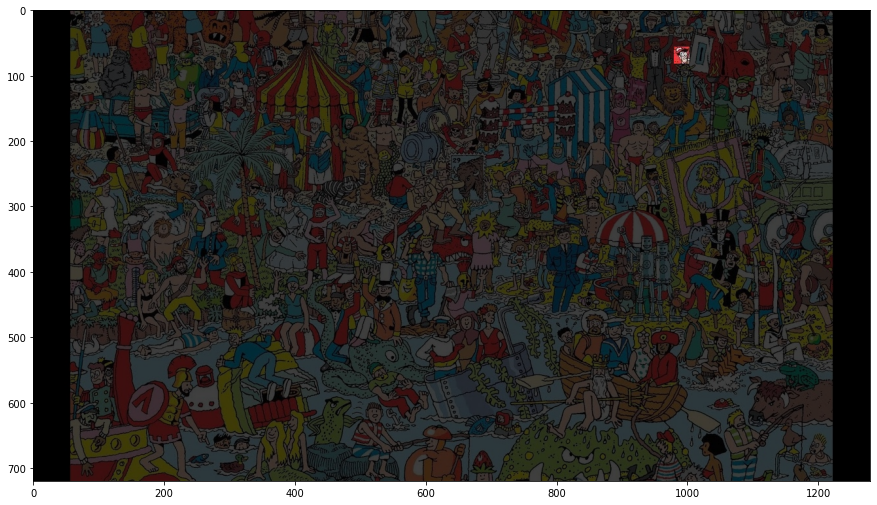

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# from google.colab.patches import cv2_imshow 

map = cv2.imread('/content/Part4_data/puzzle2/map.jpg')
waldo = cv2.imread('/content/Part4_data/puzzle2/waldo.png')

(waldoHeight, waldoWidth) = waldo.shape[:2]

result = cv2.matchTemplate(map, waldo, cv2.TM_CCOEFF)
(_, _, minLoc, maxLoc) = cv2.minMaxLoc(result)

# grab the bounding box of waldo and extract him from the puzzle image
topLeft = maxLoc
botRight = (topLeft[0] + waldoWidth, topLeft[1] + waldoHeight)
roi = map[topLeft[1] : botRight[1], topLeft[0] : botRight[0]]

# construct a darkened transparent 'layer' to darken everything
# in the map except for Waldo
mask = np.zeros(map.shape, dtype = "uint8")
map = cv2.addWeighted(map, 0.25, mask, 0.75, 0)

map[topLeft[1] : botRight[1], topLeft[0] : botRight[0]] = roi

# display the images
result_rgb = cv2.cvtColor(map, cv2.COLOR_RGB2BGR)
plt.figure(figsize = (15, 15))
plt.imshow(result_rgb)

### Subpart 2: Template Matching from Scratch

Implement the Sum of Squared Distance (SSD) template matching algorithm from scratch (Don't use cv2.matchTemplate).

Then, show the results of where's waldo for two puzzle images.

Hints: You can borrow the codes from Part1 and Part2. Please read methods for matching with filters in Lecture Slide.  

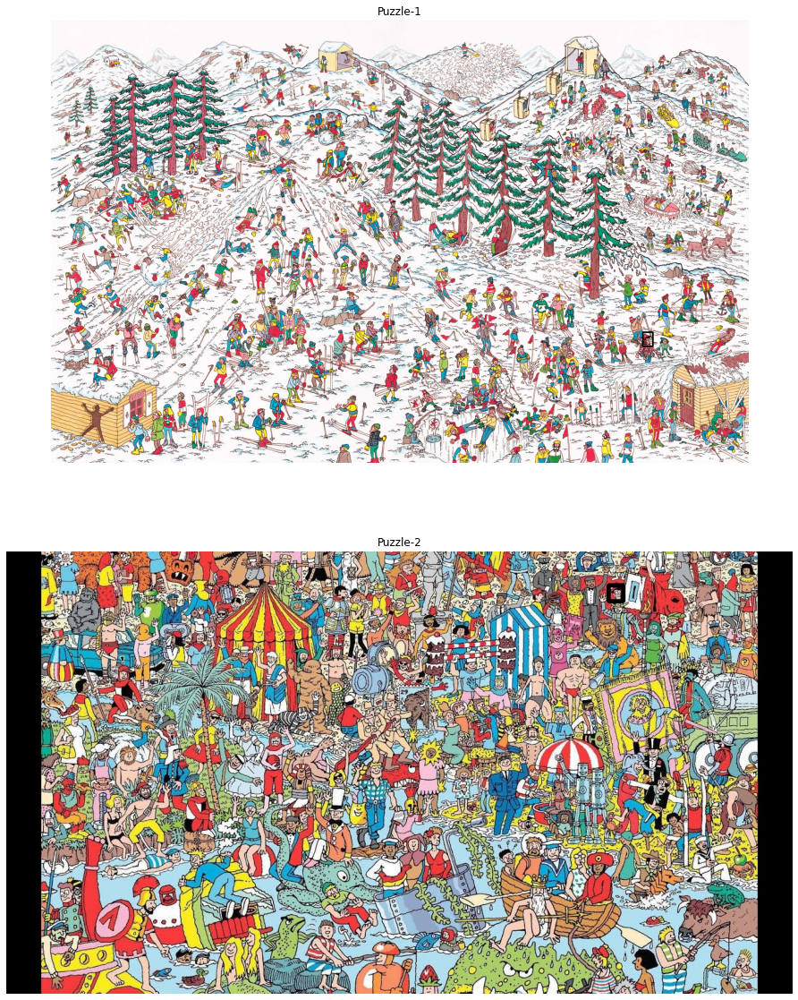

In [ ]:
import cv2
import numpy as np
# from google.colab.patches import cv2_imshow 


def SSD(img, template):
  img = img.astype('float')
  img_h, img_w = img.shape[0], img.shape[1]
  template_h, template_w = template.shape[0], template.shape[1]
  R = np.ones_like(img) * np.inf

  for i in range(img_w - template_w):
    for j in range(img_h - template_h):
      window = (img[j: j + template_h,
                    i: i + template_w] - template).ravel()
      R[j, i] = np.dot(window, window)
  return -R

def matchTemplate(image, template):
  image =  cv2.cvtColor(map, cv2.COLOR_BGR2GRAY)
  template =  cv2.cvtColor(waldo, cv2.COLOR_BGR2GRAY)

  R = SSD(image, template)

  h,w = np.unravel_index(R.argmax(), R.shape)
  temp_h, temp_w = template.shape[0], template.shape[1]
  start_point = (w,h)
  end_point = (w + temp_w, h + temp_h)

  cv2.rectangle(map,start_point, end_point, (0,0,0),5)  # Mark detected template


# Main
fig0, ax0 = plt.subplots(2, 1,figsize=(50, 20))
plt.gcf().set_facecolor('white')

# Puzzle-1
map = cv2.imread('/content/Part4_data/puzzle1/pic1.jpeg')
waldo = cv2.imread('/content/Part4_data/puzzle1/waldo.jpg')

matchTemplate(map, waldo)

ax0[0].imshow(cv2.cvtColor(map, cv2.COLOR_BGR2RGB))
ax0[0].set_title("Puzzle-1")
ax0[0].axis('off')

# Puzzle-2
map = cv2.imread('/content/Part4_data/puzzle2/map.jpg')
waldo = cv2.imread('/content/Part4_data/puzzle2/waldo.png')

matchTemplate(map, waldo)

ax0[1].imshow(cv2.cvtColor(map, cv2.COLOR_BGR2RGB))
ax0[1].set_title("Puzzle-2")
ax0[1].axis('off')
plt.show()